In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
from sklearn.model_selection import train_test_split

df= pd.read_csv('report_2018-2019.csv')

In [ ]:
df

,Overall rank,Country or region,Year,Score,GDP per capita,Social support,Healthy life expectancy,Freedom to make life choices,Generosity,Perceptions of corruption
0,154,Afghanistan,2019,3.203,0.350,0.517,0.361,0.000,0.158,0.025
1,145,Afghanistan,2018,3.632,0.332,0.537,0.255,0.085,0.191,0.036
2,107,Albania,2019,4.719,0.947,0.848,0.874,0.383,0.178,0.027
3,112,Albania,2018,4.586,0.916,0.817,0.790,0.419,0.149,0.032
4,88,Algeria,2019,5.211,1.002,1.160,0.785,0.086,0.073,0.114
...,...,...,...,...,...,...,...,...,...,...
307,152,Yemen,2018,3.355,0.442,1.073,0.343,0.244,0.083,0.064
308,138,Zambia,2019,4.107,0.578,1.058,0.426,0.431,0.247,0.087
309,125,Zambia,2018,4.377,0.562,1.047,0.295,0.503,0.221,0.082
310,146,Zimbabwe,2019,3.663,0.366,1.114,0.433,0.361,0.151,0.089


In [ ]:
df.duplicated().sum()

0

In [ ]:
df1=df.copy()

In [ ]:
df.shape

(312, 10)

In [ ]:
pd.DataFrame(df)

,Overall rank,Country or region,Year,Score,GDP per capita,Social support,Healthy life expectancy,Freedom to make life choices,Generosity,Perceptions of corruption
0,154,Afghanistan,2019,3.203,0.350,0.517,0.361,0.000,0.158,0.025
1,145,Afghanistan,2018,3.632,0.332,0.537,0.255,0.085,0.191,0.036
2,107,Albania,2019,4.719,0.947,0.848,0.874,0.383,0.178,0.027
3,112,Albania,2018,4.586,0.916,0.817,0.790,0.419,0.149,0.032
4,88,Algeria,2019,5.211,1.002,1.160,0.785,0.086,0.073,0.114
...,...,...,...,...,...,...,...,...,...,...
307,152,Yemen,2018,3.355,0.442,1.073,0.343,0.244,0.083,0.064
308,138,Zambia,2019,4.107,0.578,1.058,0.426,0.431,0.247,0.087
309,125,Zambia,2018,4.377,0.562,1.047,0.295,0.503,0.221,0.082
310,146,Zimbabwe,2019,3.663,0.366,1.114,0.433,0.361,0.151,0.089


In [ ]:
df.columns

Index(['Overall rank', 'Country or region', 'Year', 'Score', 'GDP per capita',
       'Social support', 'Healthy life expectancy',
       'Freedom to make life choices', 'Generosity',
       'Perceptions of corruption'],
      dtype='object')

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 312 entries, 0 to 311
Data columns (total 10 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Overall rank                  312 non-null    int64  
 1   Country or region             312 non-null    object 
 2   Year                          312 non-null    int64  
 3   Score                         312 non-null    float64
 4   GDP per capita                312 non-null    float64
 5   Social support                312 non-null    float64
 6   Healthy life expectancy       312 non-null    float64
 7   Freedom to make life choices  312 non-null    float64
 8   Generosity                    312 non-null    float64
 9   Perceptions of corruption     312 non-null    float64
dtypes: float64(7), int64(2), object(1)
memory usage: 24.5+ KB


In [ ]:
df.describe()

,Overall rank,Year,Score,GDP per capita,Social support,Healthy life expectancy,Freedom to make life choices,Generosity,Perceptions of corruption
count,312.000000,312.000000,312.000000,312.000000,312.000000,312.000000,312.000000,312.000000,312.000000
mean,78.500000,2018.500000,5.391506,0.898298,1.211026,0.661295,0.423538,0.182926,0.111526
std,45.104737,0.500803,1.114631,0.394592,0.300310,0.252724,0.156024,0.096739,0.095296
min,1.000000,2018.000000,2.853000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,39.750000,2018.000000,4.514250,0.609500,1.055750,0.488250,0.322500,0.108750,0.050000
50%,78.500000,2018.500000,5.379500,0.960000,1.265500,0.699000,0.449500,0.175500,0.082000
75%,117.250000,2019.000000,6.176000,1.219500,1.457500,0.858000,0.540250,0.245000,0.141250
max,156.000000,2019.000000,7.769000,2.096000,1.644000,1.141000,0.724000,0.598000,0.457000


In [ ]:
df.corr()

<ipython-input-10-2f6f6606aa2c>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  df.corr()


,Overall rank,Year,Score,GDP per capita,Social support,Healthy life expectancy,Freedom to make life choices,Generosity,Perceptions of corruption
Overall rank,1.000000e+00,4.501924e-15,-0.990325,-0.803757,-0.752372,-0.757395,-0.526428,-0.076233,-0.363329
Year,4.501924e-15,1.000000e+00,0.014009,0.017386,-0.007376,0.253444,-0.198801,0.019878,-0.009702
Score,-9.903250e-01,1.400893e-02,1.000000,0.797977,0.761080,0.755875,0.539897,0.106645,0.396947
GDP per capita,-8.037573e-01,1.738595e-02,0.797977,1.000000,0.713293,0.816590,0.342953,-0.044788,0.310951
Social support,-7.523724e-01,-7.376014e-03,0.761080,0.713293,1.000000,0.668207,0.420206,-0.014367,0.196076
Healthy life expectancy,-7.573946e-01,2.534442e-01,0.755875,0.816590,0.668207,1.000000,0.301488,0.001476,0.293554
Freedom to make life choices,-5.264284e-01,-1.988010e-01,0.539897,0.342953,0.420206,0.301488,1.000000,0.274993,0.439908
Generosity,-7.623314e-02,1.987775e-02,0.106645,-0.044788,-0.014367,0.001476,0.274993,1.000000,0.344378
Perceptions of corruption,-3.633288e-01,-9.702012e-03,0.396947,0.310951,0.196076,0.293554,0.439908,0.344378,1.000000


In [ ]:
X= df1.iloc[:,4:10]
X

,GDP per capita,Social support,Healthy life expectancy,Freedom to make life choices,Generosity,Perceptions of corruption
0,0.350,0.517,0.361,0.000,0.158,0.025
1,0.332,0.537,0.255,0.085,0.191,0.036
2,0.947,0.848,0.874,0.383,0.178,0.027
3,0.916,0.817,0.790,0.419,0.149,0.032
4,1.002,1.160,0.785,0.086,0.073,0.114
...,...,...,...,...,...,...
307,0.442,1.073,0.343,0.244,0.083,0.064
308,0.578,1.058,0.426,0.431,0.247,0.087
309,0.562,1.047,0.295,0.503,0.221,0.082
310,0.366,1.114,0.433,0.361,0.151,0.089


In [ ]:
y=df.iloc[:,3]
y

0      3.203
1      3.632
2      4.719
3      4.586
4      5.211
       ...  
307    3.355
308    4.107
309    4.377
310    3.663
311    3.692
Name: Score, Length: 312, dtype: float64

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X,y,random_state=5, test_size=0.20, shuffle=True)

In [ ]:
X_train

,GDP per capita,Social support,Healthy life expectancy,Freedom to make life choices,Generosity,Perceptions of corruption
60,0.274,0.757,0.505,0.142,0.275,0.078
237,1.379,1.331,0.633,0.509,0.098,0.127
221,0.934,1.249,0.674,0.530,0.092,0.034
193,0.879,1.313,0.477,0.401,0.070,0.056
278,0.275,0.572,0.410,0.293,0.177,0.085
...,...,...,...,...,...,...
8,1.073,1.468,0.744,0.570,0.062,0.054
73,1.383,1.573,0.996,0.592,0.252,0.410
118,0.931,1.203,0.660,0.491,0.498,0.028
189,0.204,0.986,0.390,0.494,0.197,0.138


## Things we do in Data Analysis
1. Checking missing values
2. Checking Outliers
3. Exploring Numerical and categorical variables
4. Finding relationships between features

# 1. Exploratory Data Analysis (EDA)

In [ ]:
X_train.shape

(249, 6)

In [ ]:
X_test.shape

(63, 6)

In [ ]:
y_train.info()

<class 'pandas.core.series.Series'>
Int64Index: 249 entries, 60 to 206
Series name: Score
Non-Null Count  Dtype  
--------------  -----  
249 non-null    float64
dtypes: float64(1)
memory usage: 3.9 KB


In [ ]:
y_test.info()

<class 'pandas.core.series.Series'>
Int64Index: 63 entries, 84 to 195
Series name: Score
Non-Null Count  Dtype  
--------------  -----  
63 non-null     float64
dtypes: float64(1)
memory usage: 1008.0 bytes


In [ ]:
pd.isnull(df).sum()

Overall rank                    0
Country or region               0
Year                            0
Score                           0
GDP per capita                  0
Social support                  0
Healthy life expectancy         0
Freedom to make life choices    0
Generosity                      0
Perceptions of corruption       0
dtype: int64

In [ ]:
df.isnull().sum()

Overall rank                    0
Country or region               0
Year                            0
Score                           0
GDP per capita                  0
Social support                  0
Healthy life expectancy         0
Freedom to make life choices    0
Generosity                      0
Perceptions of corruption       0
dtype: int64

In [ ]:
X_train.head(5)

,GDP per capita,Social support,Healthy life expectancy,Freedom to make life choices,Generosity,Perceptions of corruption
60,0.274,0.757,0.505,0.142,0.275,0.078
237,1.379,1.331,0.633,0.509,0.098,0.127
221,0.934,1.249,0.674,0.530,0.092,0.034
193,0.879,1.313,0.477,0.401,0.070,0.056
278,0.275,0.572,0.410,0.293,0.177,0.085


<Figure size 1000x1000 with 0 Axes>

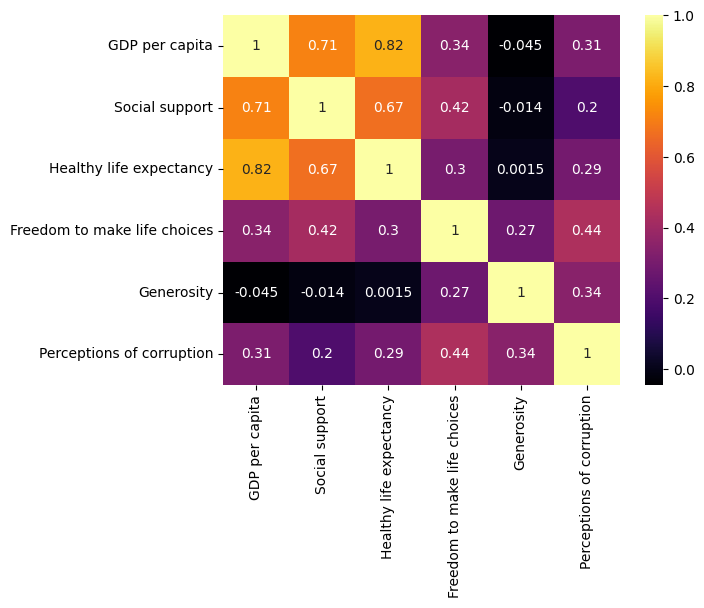

<Figure size 1000x1000 with 0 Axes>

In [ ]:
sns.heatmap(X.corr(),cmap='inferno', annot=True)
plt.figure(figsize=(10,10))

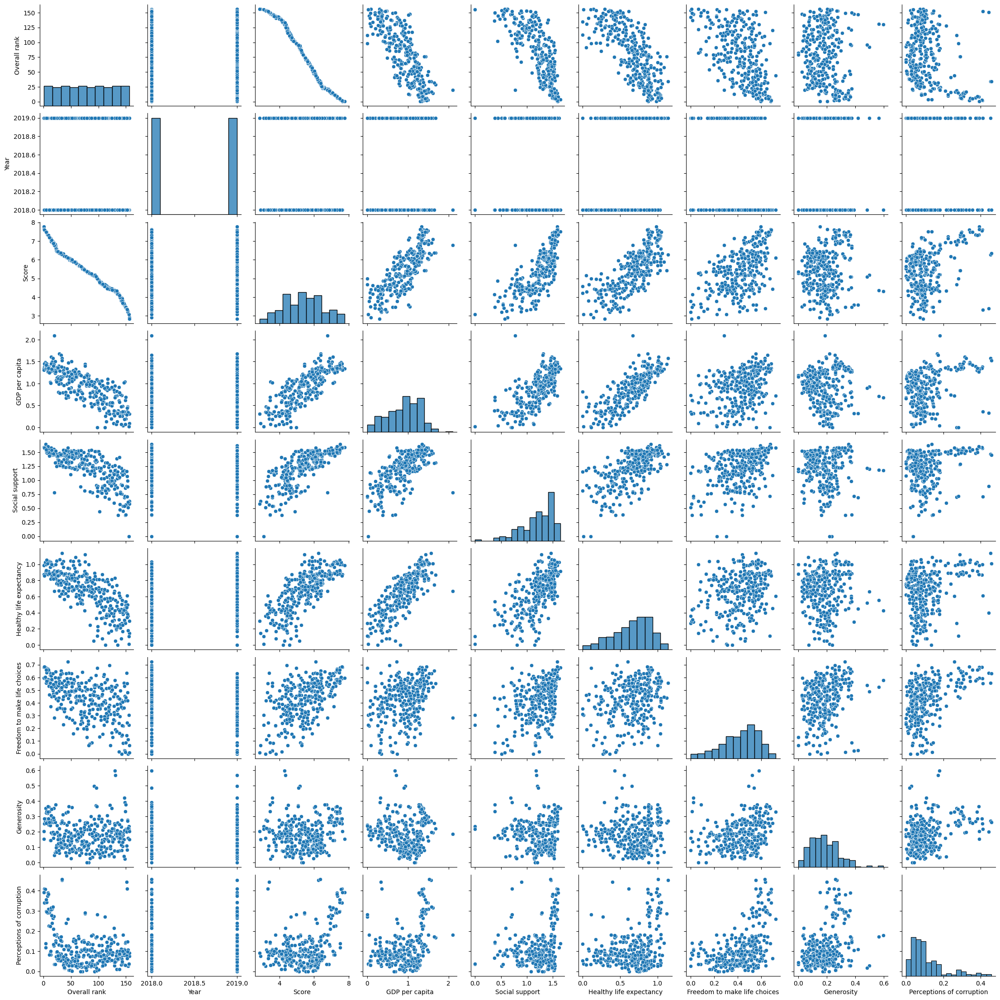

In [ ]:
sns.pairplot(df)

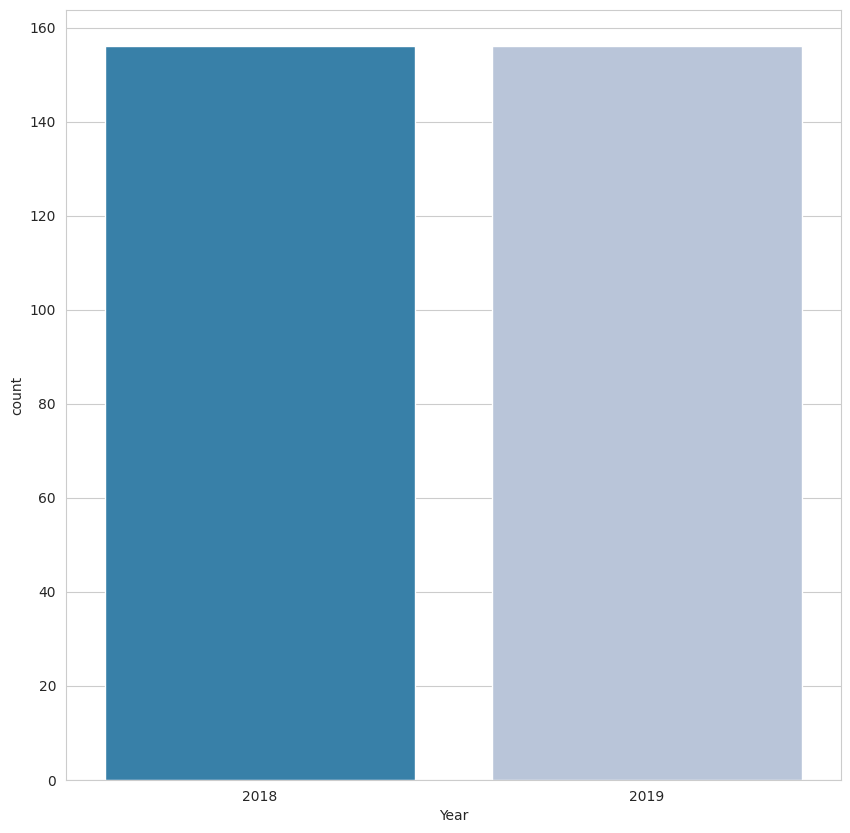

In [ ]:
%matplotlib inline
plt.figure(figsize=(10,10))
sns.set_style('whitegrid')
sns.countplot(x='Year', data=df, palette='PuBu_r')
plt.show()

<ipython-input-25-9c7a07a4aaee>:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(X_train['GDP per capita'].dropna(),kde=False,color='palegreen', bins=40)


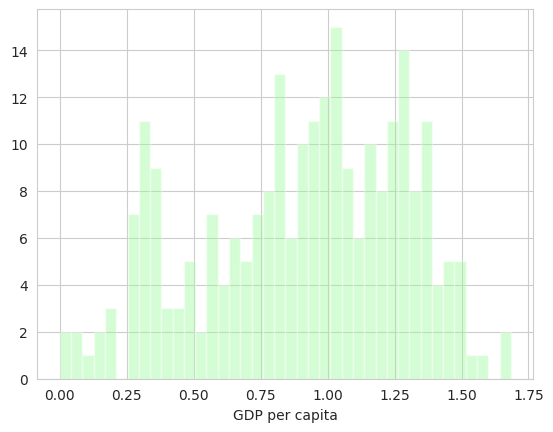

In [ ]:
sns.distplot(X_train['GDP per capita'].dropna(),kde=False,color='palegreen', bins=40)
plt.show()

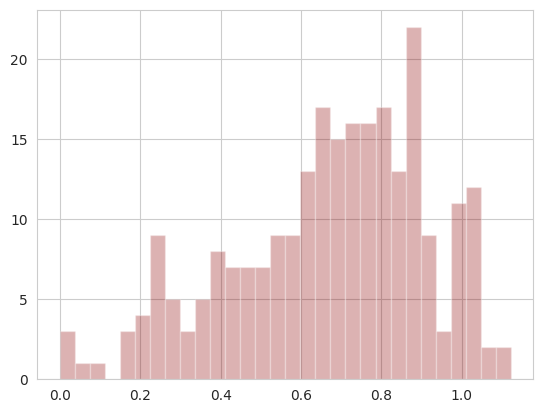

In [ ]:
X_train['Healthy life expectancy'].hist(bins=30, color='darkred', alpha= 0.3)
plt.show()

<ipython-input-27-24ba675675f9>:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(X_train['Freedom to make life choices'].dropna(),kde=False,color='teal', bins=40)


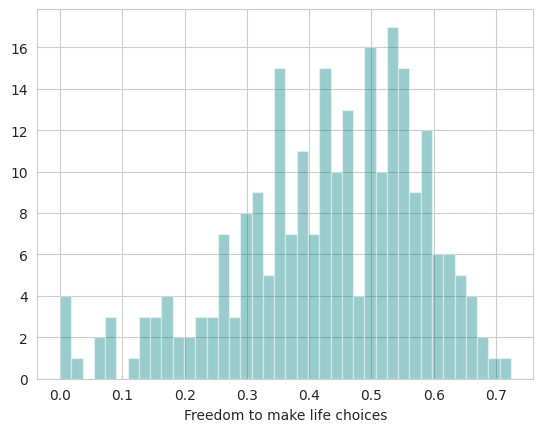

In [ ]:
sns.distplot(X_train['Freedom to make life choices'].dropna(),kde=False,color='teal', bins=40)
plt.show()

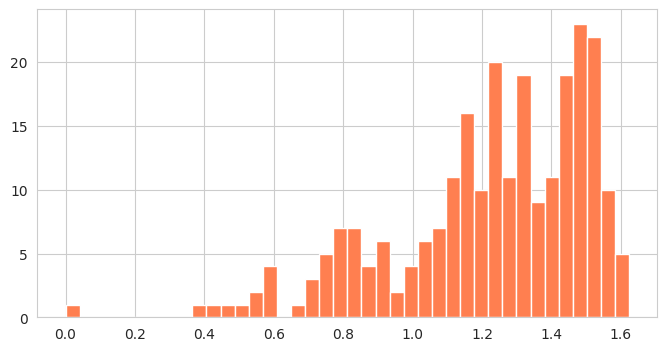

In [ ]:
X_train['Social support'].hist(color='coral',bins=40,figsize=(8,4))
plt.show()

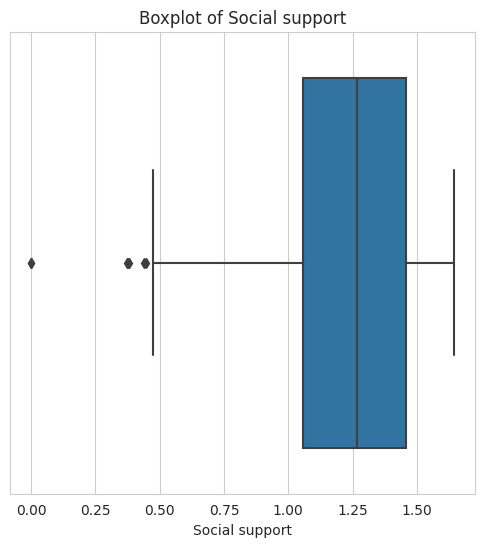

In [ ]:
# Select the feature for which you want to create a boxplot
selected_feature = 'Social support'

# Create boxplot using seaborn
plt.figure(figsize=(6, 6))
sns.boxplot(x=df[selected_feature])

plt.title(f'Boxplot of {selected_feature}')
plt.xlabel(selected_feature)

plt.show()

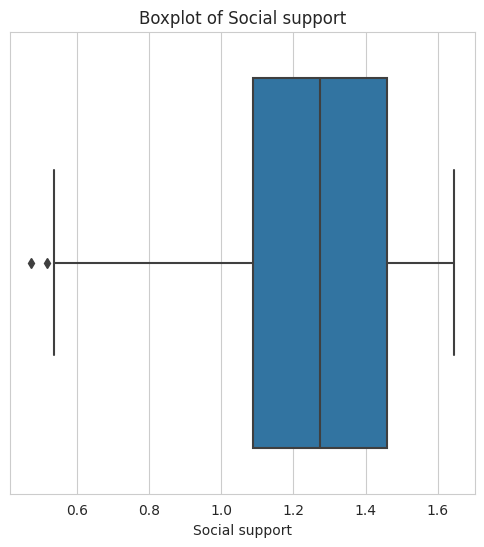

In [ ]:
Q1 = df['Social support'].quantile(0.25)
Q3 = df['Social support'].quantile(0.75)
IQR = Q3 - Q1
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Remove outliers
df= df[(df['Social support'] >= lower_bound) & (df['Social support'] <= upper_bound)]

# Select the feature for which you want to create a boxplot
selected_feature = 'Social support'

# Create boxplot using seaborn
plt.figure(figsize=(6, 6))
sns.boxplot(x=df[selected_feature])

plt.title(f'Boxplot of {selected_feature}')
plt.xlabel(selected_feature)

plt.show()

In [ ]:
pip install pandas-profiling

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 324.4/324.4 kB 4.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 357.3/357.3 kB 10.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 24.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 102.7/102.7 kB 10.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 679.5/679.5 kB 30.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 29.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.7/4.7 MB 52.5 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27081 sha256=871407c2e32d46438af892f8b9e6dc94af14208141a09c557c1fc5c5f485131e
  Stored in directory: /root/.cache/pip/wheels/dd/91/29/a79cecb328d01739e64017b6fb9a1ab9d8cb1853098ec5966d
Successfully built htmlmin
  Attempting uninstall: pydantic
    Found existing installation: pydantic 2.2.1
    Uninstalling pydantic-2.

In [ ]:
import seaborn as sns
from pandas_profiling import ProfileReport
# drop the one participant who did not submit
profile = ProfileReport(df, title='Pandas Profiling Report', explorative=True,
                       plot={
                           'correlation':{
                               'cmap': 'PuBu_r',
                               'bad': '#000000'}}
                       )
# profile.to_widgets()
profile.to_notebook_iframe()

<ipython-input-32-c7c8166ec602>:2: DeprecationWarning: `import pandas_profiling` is going to be deprecated by April 1st. Please use `import ydata_profiling` instead.
  from pandas_profiling import ProfileReport


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
pip install autoviz==0.1.730

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.0/67.0 kB 2.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.5/18.5 MB 29.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 358.9/358.9 kB 18.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.3/4.3 MB 75.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 95.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 79.5 MB/s eta 0:00:00
INFO: pip is looking at multiple versions of panel to determine which version is compatible with other requirements. This could take a while.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.0/20.0 MB 69.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.0/20.0 MB 60.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.0/20.0 MB 16.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.0/20.0 MB 40.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 19.9/19.9

In [ ]:
from autoviz import AutoViz_Class
AV = AutoViz_Class()
dft = AV.AutoViz('report_2018-2019.csv')

Imported v0.1.730. After importing autoviz, execute '%matplotlib inline' to display charts inline.
    AV = AutoViz_Class()
    dfte = AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=1, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)
Shape of your Data Set loaded: (312, 10)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
    10 Predictors classified...
        No variables removed since no ID or low-information variables found in data set
To fix data quality issues automatically, import FixDQ from autoviz...


,Data Type,Missing Values%,Unique Values%,Minimum Value,Maximum Value,DQ Issue
Overall rank,int64,0.000000,50,1.000000,156.000000,No issue
Country or region,object,0.000000,51,nan,nan,"160 rare categories: Too many to list. Group them into a single category or drop the categories., high cardinality with 160 unique values: Use hash encoding or embedding to reduce dimension."
Year,int64,0.000000,0,2018.000000,2019.000000,No issue
Score,float64,0.000000,NA,2.853000,7.769000,has a high correlation with ['Overall rank']. Consider dropping one of them.
GDP per capita,float64,0.000000,NA,0.000000,2.096000,has a high correlation with ['Overall rank']. Consider dropping one of them.
Social support,float64,0.000000,NA,0.000000,1.644000,has 7 outliers greater than upper bound (2.06) or lower than lower bound(0.45). Cap them or remove them.
Healthy life expectancy,float64,0.000000,NA,0.000000,1.141000,has a high correlation with ['GDP per capita']. Consider dropping one of them.
Freedom to make life choices,float64,0.000000,NA,0.000000,0.724000,No issue
Generosity,float64,0.000000,NA,0.000000,0.598000,has 4 outliers greater than upper bound (0.45) or lower than lower bound(-0.10). Cap them or remove them.
Perceptions of corruption,float64,0.000000,NA,0.000000,0.457000,has 30 outliers greater than upper bound (0.28) or lower than lower bound(-0.09). Cap them or remove them.


Number of All Scatter Plots = 28


[nltk_data] Downloading collection 'popular'
[nltk_data]    | 
[nltk_data]    | Downloading package cmudict to /root/nltk_data...
[nltk_data]    |   Unzipping corpora/cmudict.zip.
[nltk_data]    | Downloading package gazetteers to /root/nltk_data...
[nltk_data]    |   Unzipping corpora/gazetteers.zip.
[nltk_data]    | Downloading package genesis to /root/nltk_data...
[nltk_data]    |   Unzipping corpora/genesis.zip.
[nltk_data]    | Downloading package gutenberg to /root/nltk_data...
[nltk_data]    |   Unzipping corpora/gutenberg.zip.
[nltk_data]    | Downloading package inaugural to /root/nltk_data...
[nltk_data]    |   Unzipping corpora/inaugural.zip.
[nltk_data]    | Downloading package movie_reviews to
[nltk_data]    |     /root/nltk_data...
[nltk_data]    |   Unzipping corpora/movie_reviews.zip.
[nltk_data]    | Downloading package names to /root/nltk_data...
[nltk_data]    |   Unzipping corpora/names.zip.
[nltk_data]    | Downloading package shakespeare to /root/nltk_data...
[nlt

All Plots done
Time to run AutoViz = 32 seconds 

 ###################### AUTO VISUALIZATION Completed ########################


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from autoviz.AutoViz_Class import AutoViz_Class

AV = AutoViz_Class()



filename = "report_2018-2019.csv"
sep = ","
dft = AV.AutoViz(
    filename,
    sep=",",
    depVar="",
    dfte=None,
    header=0,
    verbose=0,
    lowess=False,
    chart_format="svg",
    max_rows_analyzed=150000,
    max_cols_analyzed=30,
)


Shape of your Data Set loaded: (312, 10)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
    Number of Numeric Columns =  7
    Number of Integer-Categorical Columns =  1
    Number of String-Categorical Columns =  0
    Number of Factor-Categorical Columns =  0
    Number of String-Boolean Columns =  0
    Number of Numeric-Boolean Columns =  1
    Number of Discrete String Columns =  1
    Number of NLP String Columns =  0
    Number of Date Time Columns =  0
    Number of ID Columns =  0
    Number of Columns to Delete =  0
    10 Predictors classified...
        No variables removed since no ID or low-information variables found in data set
Number of All Scatter Plots = 28


[nltk_data] Downloading collection 'popular'
[nltk_data]    | 
[nltk_data]    | Downloading package cmudict to /root/nltk_data...
[nltk_data]    |   Package cmudict is already up-to-date!
[nltk_data]    | Downloading package gazetteers to /root/nltk_data...
[nltk_data]    |   Package gazetteers is already up-to-date!
[nltk_data]    | Downloading package genesis to /root/nltk_data...
[nltk_data]    |   Package genesis is already up-to-date!
[nltk_data]    | Downloading package gutenberg to /root/nltk_data...
[nltk_data]    |   Package gutenberg is already up-to-date!
[nltk_data]    | Downloading package inaugural to /root/nltk_data...
[nltk_data]    |   Package inaugural is already up-to-date!
[nltk_data]    | Downloading package movie_reviews to
[nltk_data]    |     /root/nltk_data...
[nltk_data]    |   Package movie_reviews is already up-to-date!
[nltk_data]    | Downloading package names to /root/nltk_data...
[nltk_data]    |   Package names is already up-to-date!
[nltk_data]    | Do

All Plots done
Time to run AutoViz = 18 seconds 

 ###################### AUTO VISUALIZATION Completed ########################


In [ ]:
df2=df.iloc[:,3:10];df2

,Score,GDP per capita,Social support,Healthy life expectancy,Freedom to make life choices,Generosity,Perceptions of corruption
0,3.203,0.350,0.517,0.361,0.000,0.158,0.025
1,3.632,0.332,0.537,0.255,0.085,0.191,0.036
2,4.719,0.947,0.848,0.874,0.383,0.178,0.027
3,4.586,0.916,0.817,0.790,0.419,0.149,0.032
4,5.211,1.002,1.160,0.785,0.086,0.073,0.114
5,5.295,0.979,1.154,0.687,0.077,0.055,0.135
6,3.795,0.730,1.125,0.269,0.000,0.079,0.061
7,6.086,1.092,1.432,0.881,0.471,0.066,0.050
8,6.388,1.073,1.468,0.744,0.570,0.062,0.054
9,4.559,0.850,1.055,0.815,0.283,0.095,0.064


In [ ]:
num_features=[cols for cols in df2.columns if df2[cols].dtype !='0'];num_features

['Score',
 'GDP per capita',
 'Social support',
 'Healthy life expectancy',
 'Freedom to make life choices',
 'Generosity',
 'Perceptions of corruption']

In [ ]:
plt.figure(figsize=(10,12))
sns.set(style="whitegrid")
plt.suptitle('Univariate Analysis: Box plots',fontsize=15)
for i in range(0,len(num_features)):
    plt.subplot(4,2,i+1)
    sns.boxplot(df2[num_features[i]], palette="viridis")
    plt.xlabel(num_features[i])
    plt.tight_layout()

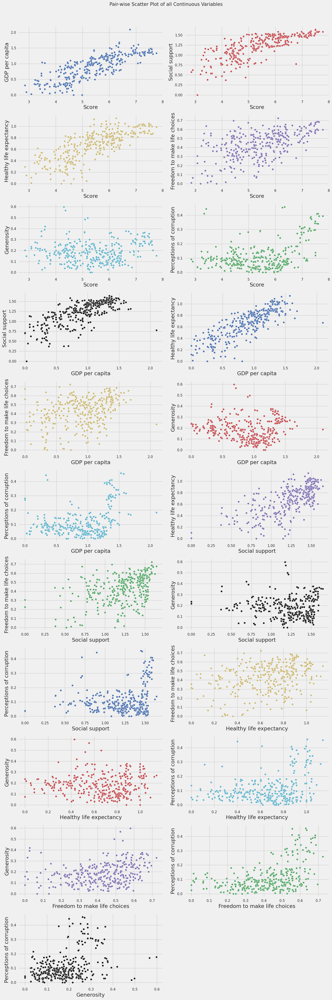

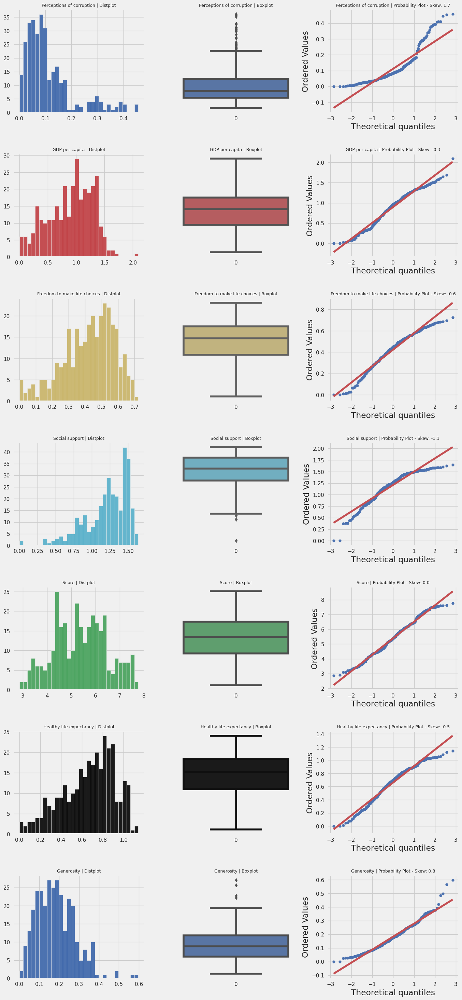

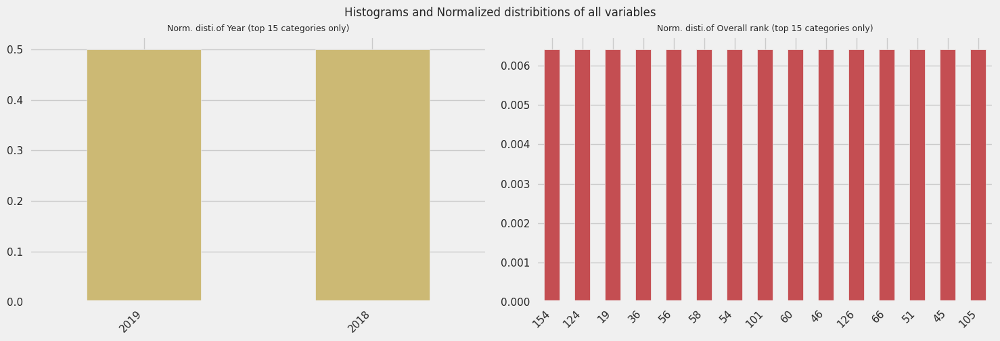

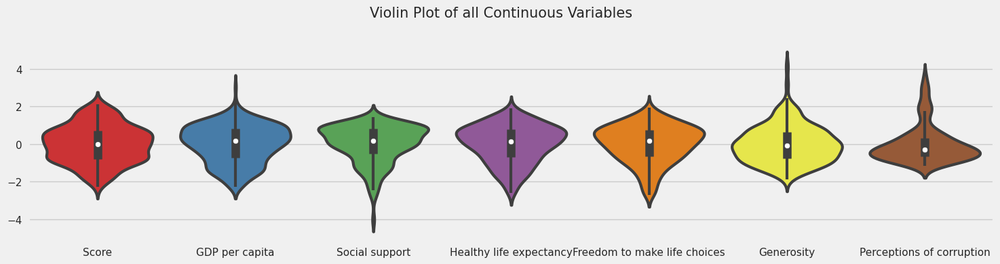

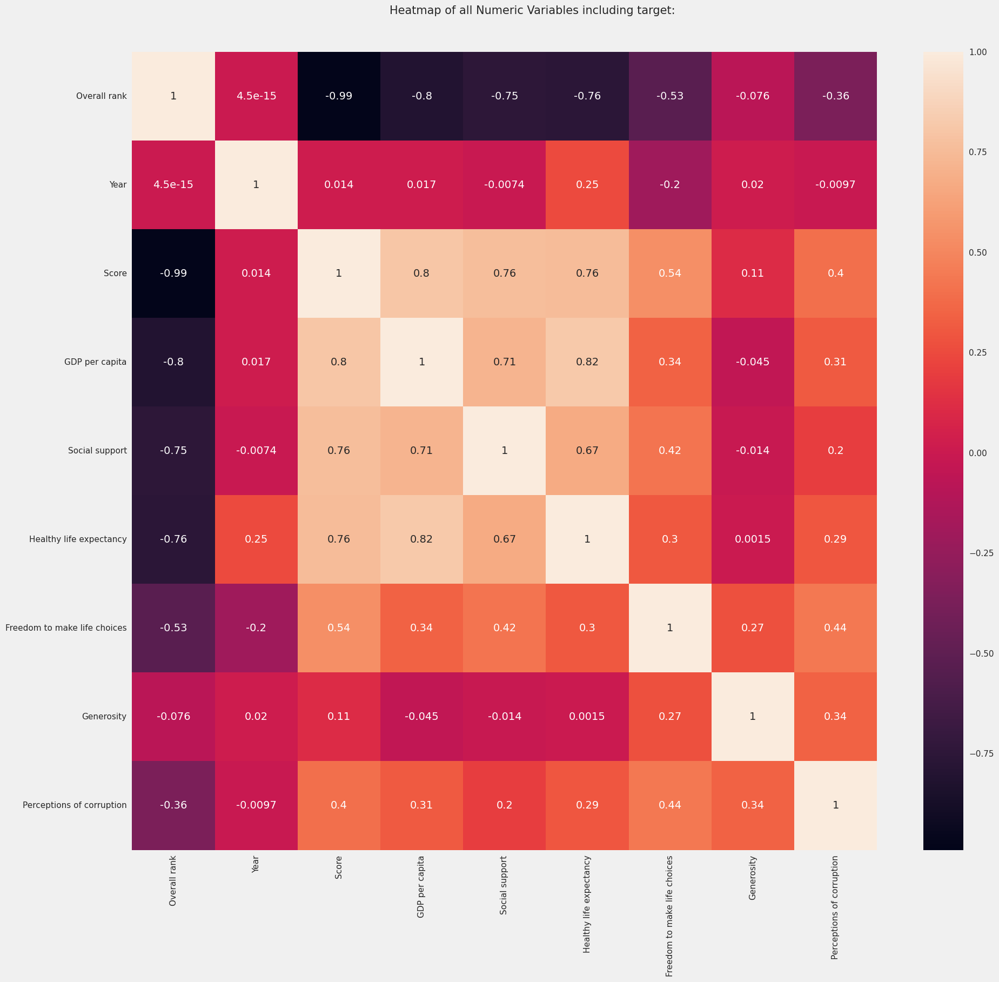

...

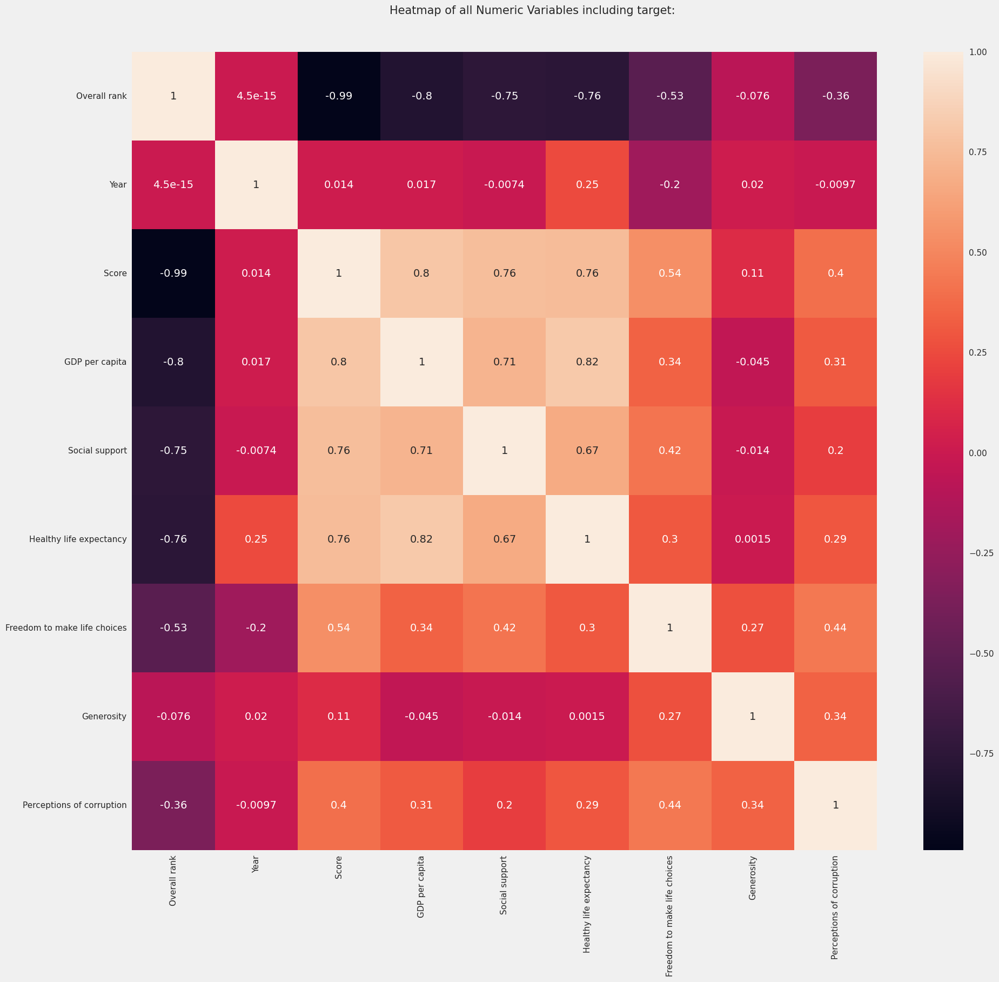

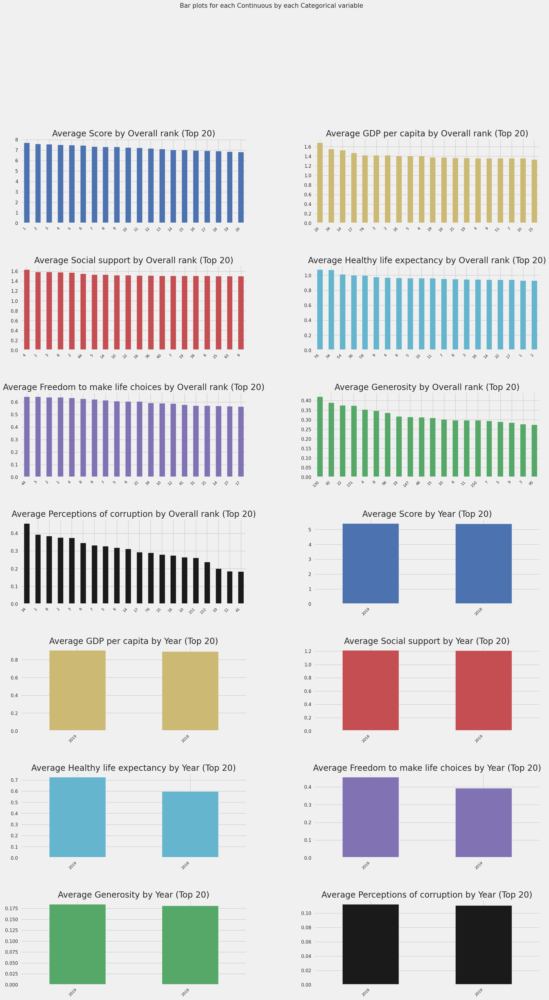

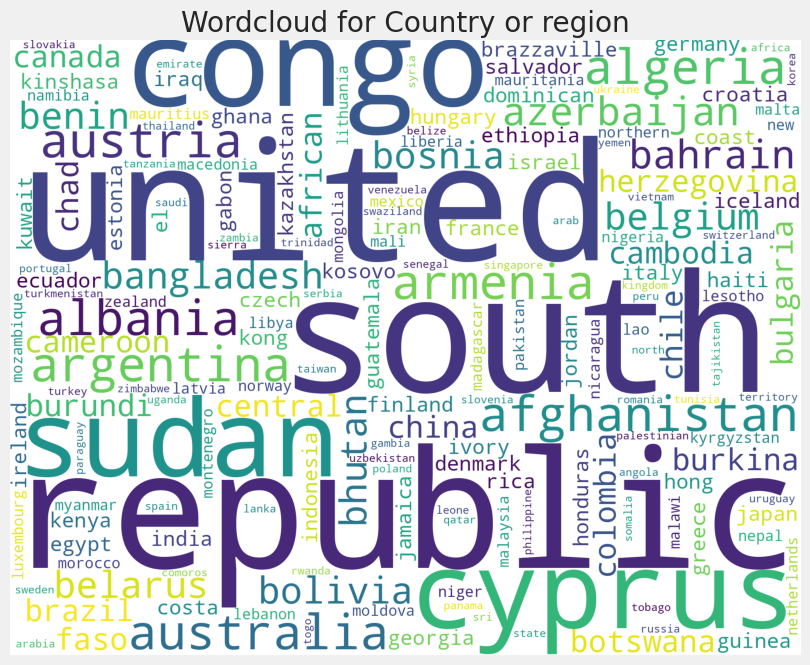

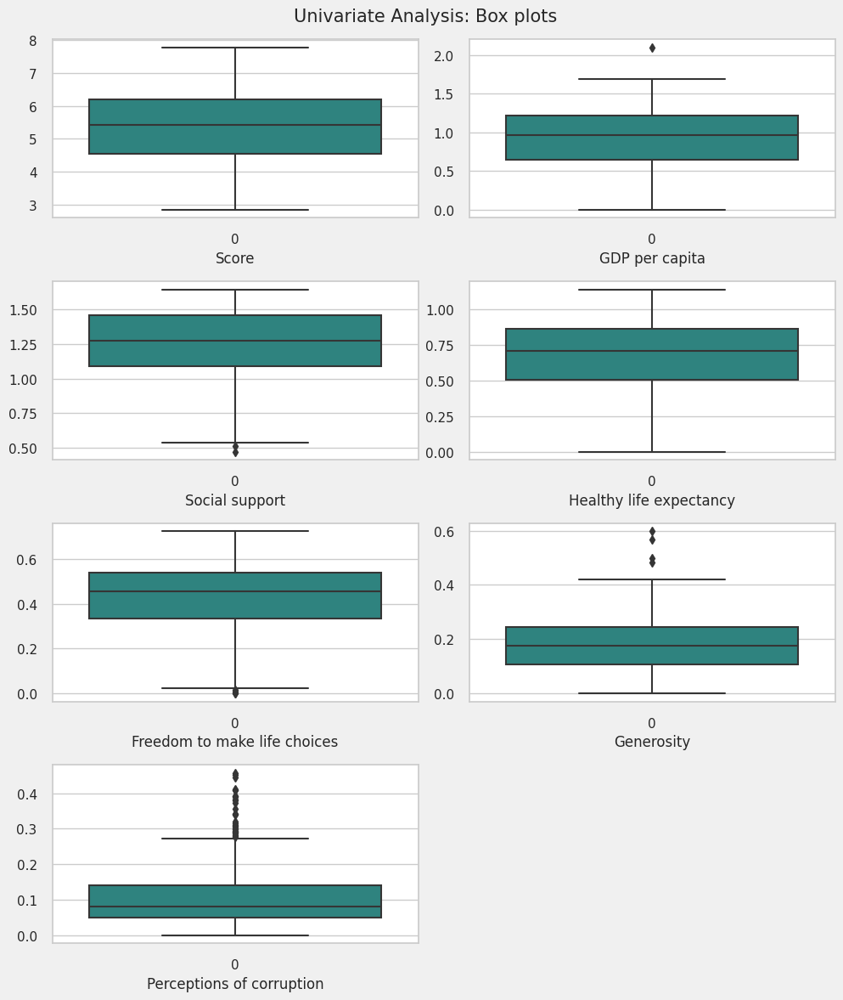

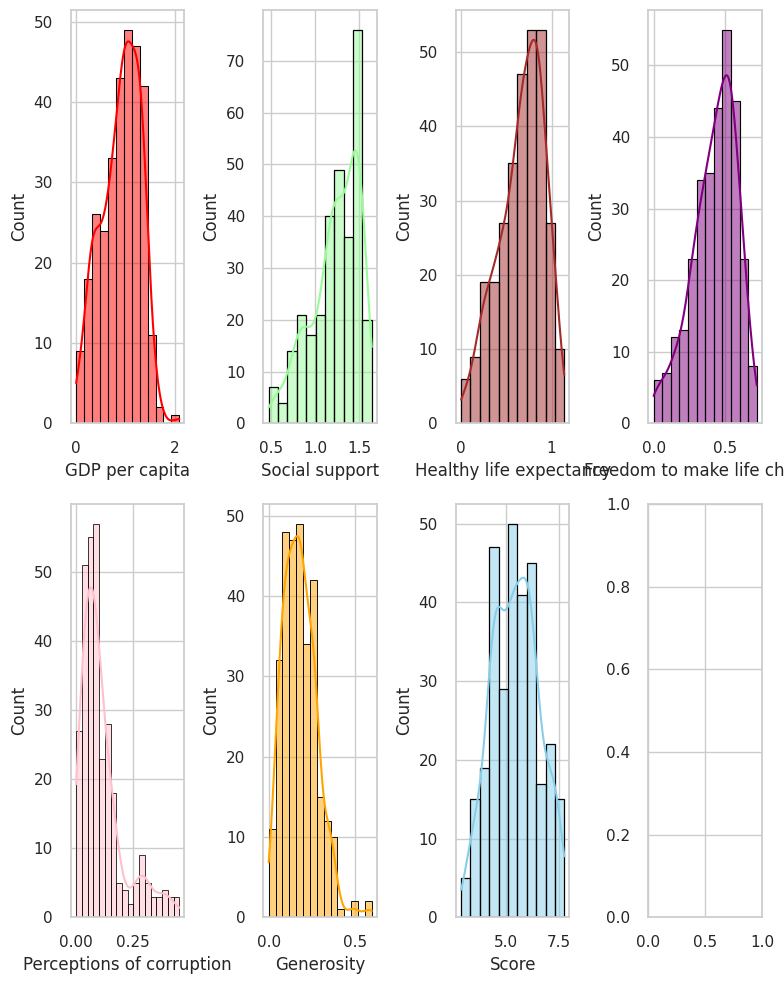

In [ ]:
import seaborn as sns
%matplotlib inline
import matplotlib.pyplot as plt
sns.set(style="whitegrid")
fig,axs = plt.subplots(2,4, figsize = (8,10))
sns.histplot(data=df, x="GDP per capita", kde=True, color="red",edgecolor = "black", ax=axs[0, 0])
sns.histplot(data=df, x="Social support", kde=True, color="palegreen",edgecolor = "black", ax=axs[0, 1])
sns.histplot(data=df, x="Healthy life expectancy", kde=True, color="brown",edgecolor = "black", ax=axs[0, 2])
sns.histplot(data=df, x="Freedom to make life choices", kde=True, color="purple",edgecolor = "black", ax=axs[0, 3])
sns.histplot(data=df, x="Perceptions of corruption", kde=True, color="pink",edgecolor = "black", ax=axs[1, 0])
sns.histplot(data=df, x="Generosity", kde=True, color="orange",edgecolor = "black", ax=axs[1, 1])
sns.histplot(data=df, x="Score", kde=True, color="skyblue",edgecolor = "black", ax=axs[1, 2])
fig.tight_layout()

## Bar Chart for Dependent Variable


In [ ]:
import plotly.express as px
# Calculate the total happiness score for each country
df_unique = df.drop_duplicates(subset=["Country or region"])

# Calculate the total happiness score for each unique country
df_unique['Total Score'] = df_unique[['Score']].sum(axis=1)

# Create a bar plot of Total Score based on unique country using Plotly
fig = px.bar(df_unique, x="Country or region", y="Total Score", title="Total Happiness Scores by Unique Country")
fig.update_xaxes(categoryorder="total descending")  # Order countries by descending total score
fig.show()


# 2. Linear Regression

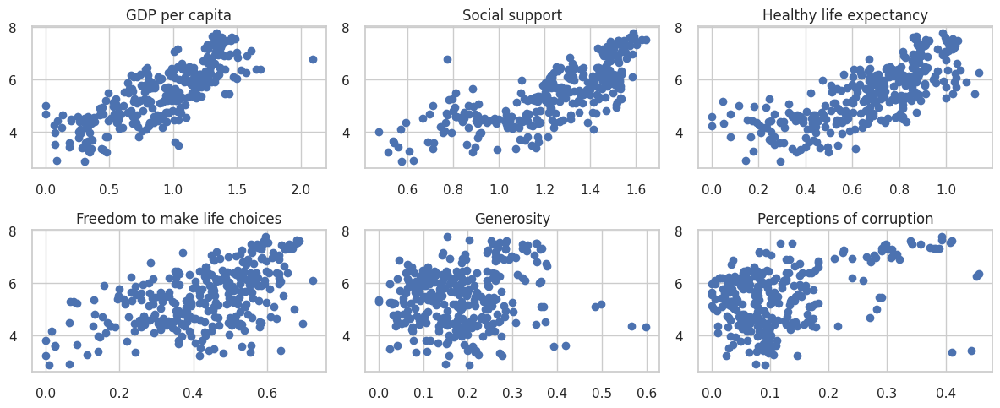

In [ ]:
fig, ((ax1, ax2, ax3), (ax4, ax5, ax6)) = plt.subplots(ncols=3, nrows=2, figsize=(12, 5))

ax1.scatter(df['GDP per capita'], df['Score'])
ax1.set_title("GDP per capita")

ax2.scatter(df['Social support'], df['Score'])
ax2.set_title("Social support")

ax3.scatter(df['Healthy life expectancy'], df['Score'])
ax3.set_title("Healthy life expectancy")

ax4.scatter(df['Freedom to make life choices'], df['Score'])
ax4.set_title("Freedom to make life choices")

ax5.scatter(df['Generosity'], df['Score'])
ax5.set_title("Generosity")

ax6.scatter(df['Perceptions of corruption'], df['Score'])
ax6.set_title("Perceptions of corruption")

plt.tight_layout()
plt.show()

In [ ]:
# load statmodels functions
from statsmodels.stats.outliers_influence import variance_inflation_factor

In [ ]:
# compute the vif for all given features
def compute_vif(considered_features):

    X =df[['GDP per capita', 'Social support', 'Healthy life expectancy', 'Freedom to make life choices', 'Generosity', 'Perceptions of corruption', 'Score']]
    # the calculation of variance inflation requires a constant
    X['intercept'] = 1

    # create dataframe to store vif values
    vif = pd.DataFrame()
    vif["Variable"] = X.columns
    vif["VIF"] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
    vif = vif[vif['Variable']!='intercept']
    return vif

In [ ]:
compute_vif(['GDP per capita', 'Social support', 'Healthy life expectancy', 'Freedom to make life choices', 'Generosity', 'Perceptions of corruption', 'Score'])

,Variable,VIF
0,GDP per capita,4.067108
1,Social support,2.672683
2,Healthy life expectancy,3.221805
3,Freedom to make life choices,1.661977
4,Generosity,1.249560
5,Perceptions of corruption,1.485782
6,Score,4.524588


In [ ]:
import numpy as np
import pandas as pd
import statsmodels.api as sm

from sklearn.linear_model import LinearRegression
from sklearn.model_selection import cross_val_score
lin_reg=LinearRegression()
mse=cross_val_score(lin_reg, X_train, y_train, cv=65)
mean_mse=np.mean(mse)
print(mean_mse)

0.21540789546361


In [ ]:
model = LinearRegression().fit(X_train, y_train)

In [ ]:
model.predict(X_test)

array([6.26225911, 5.78443431, 4.79532824, 2.37082441, 6.18037744,
       3.47551917, 5.65887335, 4.02874453, 6.38451332, 6.92318117,
       5.20627221, 4.58384732, 4.79871921, 5.6565525 , 6.18358612,
       6.94114341, 6.24217471, 4.23935883, 5.54358544, 6.14816399,
       6.13508037, 4.36698865, 3.77155272, 5.75968149, 3.64965454,
       5.07078473, 4.87150486, 6.20513438, 4.02427142, 5.95527797,
       6.33908159, 4.6078897 , 6.61368437, 5.06309522, 2.95183436,
       5.4787289 , 4.31767692, 6.91089296, 4.16561615, 4.6758226 ,
       5.69993289, 3.23310896, 3.88058168, 6.43190062, 3.61624607,
       5.18134103, 5.29858416, 5.38820487, 5.38190338, 6.90259581,
       5.64124227, 6.96892493, 5.55047445, 5.18714693, 3.87949345,
       4.30546381, 6.64670478, 6.22610682, 4.54439785, 7.20222608,
       4.47178336, 7.00766437, 5.09697208])

In [ ]:
# Residual
y_pred = model.predict(X_test)
residual = y_test - y_pred

In [ ]:
from sklearn.metrics import r2_score
r2_score1=r2_score(y_pred,y_test);r2_score1

0.7842610131348837

In [ ]:
from sklearn.metrics import mean_squared_error

In [ ]:
mse = mean_squared_error(y_test, y_pred);mse

0.27563283764487057

In [ ]:
X

,GDP per capita,Social support,Healthy life expectancy,Freedom to make life choices,Generosity,Perceptions of corruption
0,0.350,0.517,0.361,0.000,0.158,0.025
1,0.332,0.537,0.255,0.085,0.191,0.036
2,0.947,0.848,0.874,0.383,0.178,0.027
3,0.916,0.817,0.790,0.419,0.149,0.032
4,1.002,1.160,0.785,0.086,0.073,0.114
5,0.979,1.154,0.687,0.077,0.055,0.135
6,0.730,1.125,0.269,0.000,0.079,0.061
7,1.092,1.432,0.881,0.471,0.066,0.050
8,1.073,1.468,0.744,0.570,0.062,0.054
9,0.850,1.055,0.815,0.283,0.095,0.064


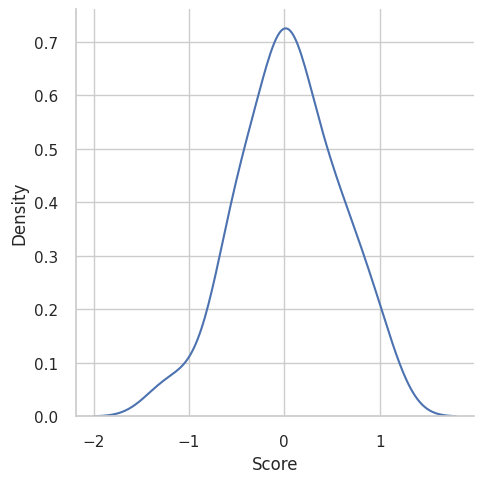

In [ ]:
sns.displot(residual, kind='kde')

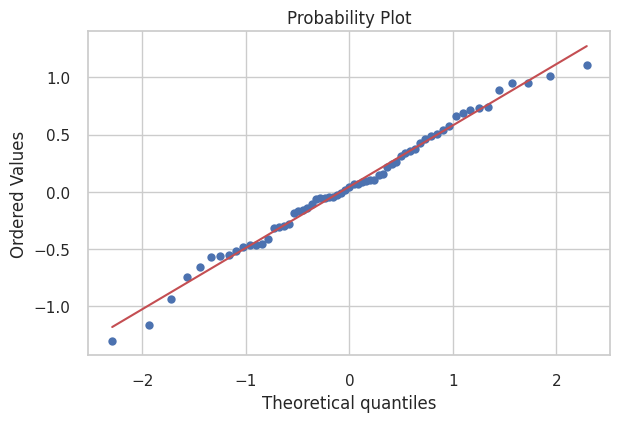

In [ ]:
# QQ Plot
import scipy as sp
fig, ax = plt.subplots(figsize=(6,4))
sp.stats.probplot(residual, plot=ax, fit=True)
plt.show()

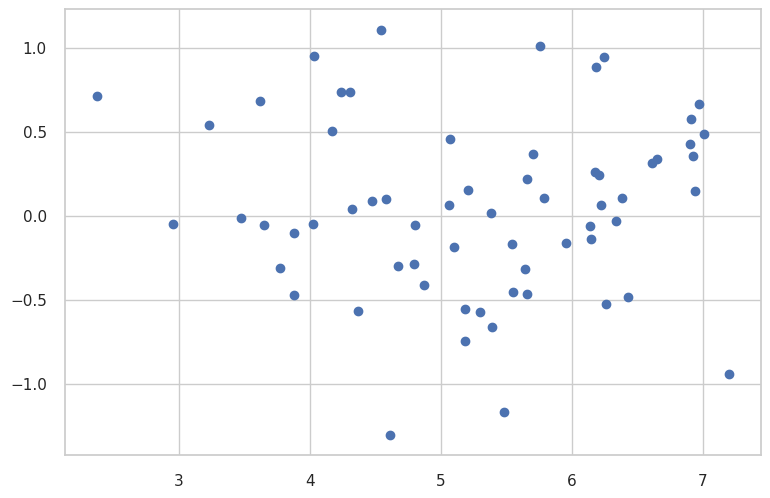

In [ ]:
plt.scatter(y_pred, residual)

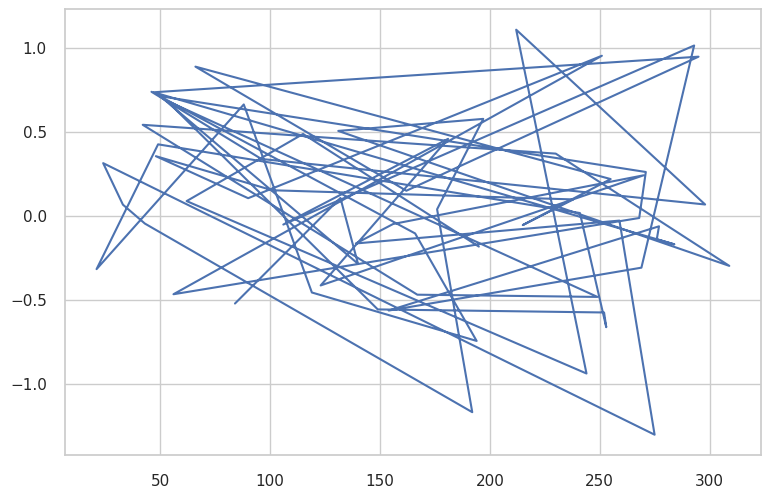

In [ ]:
plt.plot(residual)

<Axes: xlabel='Score'>

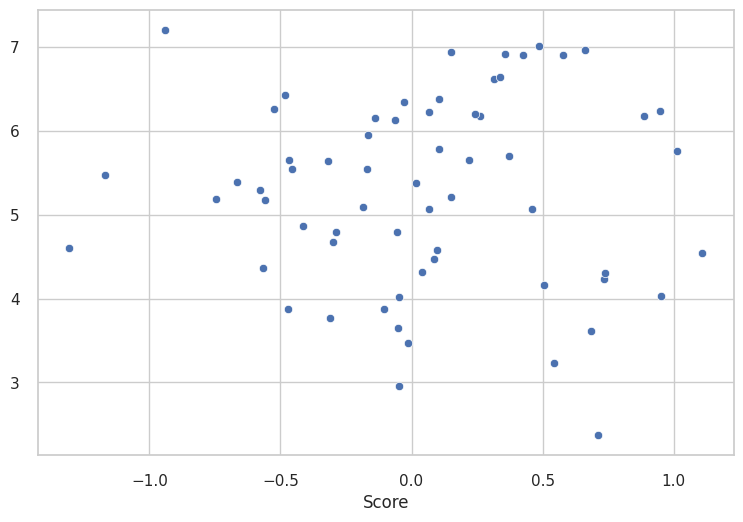

In [ ]:
sns.scatterplot(x=residual,y=y_pred)

In [ ]:
import statsmodels.api as sm
#Define the model
X=sm.add_constant(X)
model=sm.OLS(y,X)

#Fit the model
result=model.fit()

#Print the model summary
print(result.summary())

                            OLS Regression Results                            
Dep. Variable:                  Score   R-squared:                       0.784
Model:                            OLS   Adj. R-squared:                  0.779
Method:                 Least Squares   F-statistic:                     184.0
Date:                Fri, 01 Sep 2023   Prob (F-statistic):           3.21e-98
Time:                        15:18:24   Log-Likelihood:                -237.33
No. Observations:                 312   AIC:                             488.7
Df Residuals:                     305   BIC:                             514.9
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                   coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const           

### Ridge Regression

In [ ]:
from sklearn.linear_model import Ridge
from sklearn.model_selection import GridSearchCV
ridge=Ridge( )
params={'alpha':[1e-15, 1e-10, 1e-8, 1e-3, 1e-2, 1, 5, 10, 20]}
ridge_regressor=GridSearchCV(ridge, params, scoring='neg_mean_squared_error', cv=5)
ridge_regressor.fit(X_train, y_train)

GridSearchCV(cv=5, estimator=Ridge(),
             param_grid={'alpha': [1e-15, 1e-10, 1e-08, 0.001, 0.01, 1, 5, 10,
                                   20]},
             scoring='neg_mean_squared_error')

In [ ]:
print(ridge_regressor.best_params_)
print(ridge_regressor.best_score_)

{'alpha': 1}
-0.2867193095935409


In [ ]:
y_pred=ridge_regressor.predict(X_test)
from sklearn.metrics import r2_score
r2_score1=r2_score(y_pred,y_test);r2_score1

0.7755969988266749

In [ ]:
mse = mean_squared_error(y_test, y_pred);mse

0.27307633074035165

### Lasso Regression

In [ ]:
from sklearn.linear_model import Lasso
from sklearn.model_selection import GridSearchCV
lasso=Lasso( )
params={'alpha':[1e-15, 1e-10, 1e-8, 1e-3, 1e-2, 1, 5, 10, 20]}
lasso_regressor=GridSearchCV(lasso, params, scoring='neg_mean_squared_error', cv=5)
lasso_regressor.fit(X_train, y_train)

GridSearchCV(cv=5, estimator=Lasso(),
             param_grid={'alpha': [1e-15, 1e-10, 1e-08, 0.001, 0.01, 1, 5, 10,
                                   20]},
             scoring='neg_mean_squared_error')

In [ ]:
print(lasso_regressor.best_params_)
print(lasso_regressor.best_score_)

{'alpha': 1e-10}
-0.2923826209180783


In [ ]:
y_pred=lasso_regressor.predict(X_test)
from sklearn.metrics import r2_score
r2_score1=r2_score(y_pred,y_test)
mse = mean_squared_error(y_test, y_pred)

In [ ]:
print(r2_score1)

0.7842610131126967


In [ ]:
print(mse)

0.27563283752665396


## Polynomial Regression

Mean Squared Error: 0.21742472911217608
R2 Score:0.758841312415654


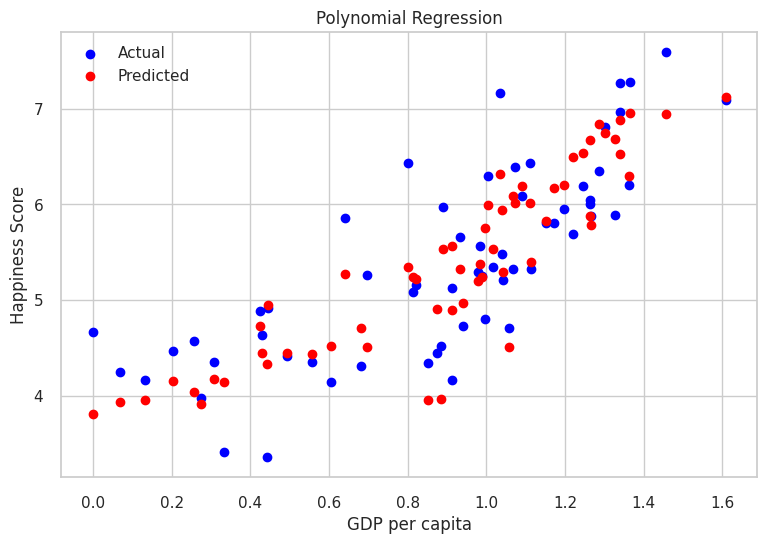

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import PolynomialFeatures
from sklearn.metrics import mean_squared_error

# Define independent variables (features)
independent_vars = ['GDP per capita', 'Social support', 'Healthy life expectancy']

# Define the dependent variable (target)
dependent_var = 'Score'

# Split the data into training and testing sets
X = df[independent_vars]
y = df[dependent_var]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Fit polynomial regression
degree = 2  # Adjust the degree of polynomial
poly_features = PolynomialFeatures(degree=degree)
X_train_poly = poly_features.fit_transform(X_train)
X_test_poly = poly_features.transform(X_test)

model = LinearRegression()
model.fit(X_train_poly, y_train)

# Predict on test data
y_pred = model.predict(X_test_poly)

# Calculate Mean Squared Error
mse = mean_squared_error(y_test, y_pred)
print(f"Mean Squared Error: {mse}")

r2_score1=r2_score(y_pred,y_test)
print(f"R2 Score:{r2_score1}")

# Visualize the results
plt.scatter(X_test['GDP per capita'], y_test, color='blue', label='Actual')
plt.scatter(X_test['GDP per capita'], y_pred, color='red', label='Predicted')
plt.xlabel('GDP per capita')
plt.ylabel('Happiness Score')
plt.legend()
plt.title('Polynomial Regression')
plt.show()

In [ ]:
# imoprt the Library for polynomial
from sklearn.preprocessing import PolynomialFeatures
# define a fuction to save our data in the fuction
poly_reg=PolynomialFeatures(degree=2) # Lets see the formula of different reg
X_poly=poly_reg.fit_transform(X)
poly_reg.fit(X_poly, y)
# define these fuction for polynomial
lin_reg_2=LinearRegression()
lin_reg_2.fit(X_poly,y)

LinearRegression()

In [ ]:
X_poly

array([[1.      , 0.35    , 0.517   , ..., 0.267289, 0.186637, 0.130321],
       [1.      , 0.332   , 0.537   , ..., 0.288369, 0.136935, 0.065025],
       [1.      , 0.947   , 0.848   , ..., 0.719104, 0.741152, 0.763876],
       ...,
       [1.      , 0.562   , 1.047   , ..., 1.096209, 0.308865, 0.087025],
       [1.      , 0.366   , 1.114   , ..., 1.240996, 0.482362, 0.187489],
       [1.      , 0.357   , 1.094   , ..., 1.196836, 0.271312, 0.061504]])

In [ ]:
# Fitting Polynomial Regression to the dataset
from sklearn.preprocessing import PolynomialFeatures

poly = PolynomialFeatures(degree=4)
X_poly = poly.fit_transform(X_train)

poly.fit(X_poly, y_train)
lin2 = LinearRegression()
lin2.fit(X_poly, y_train)

LinearRegression()

[Text(0.445086467648606, 0.96875, 'x[1] <= 1.218\nsquared_error = 1.245\nsamples = 244\nvalue = 5.439'),
 Text(0.18777945817990532, 0.90625, 'x[0] <= 0.491\nsquared_error = 0.527\nsamples = 102\nvalue = 4.492'),
 Text(0.06680694371383482, 0.84375, 'x[1] <= 0.712\nsquared_error = 0.303\nsamples = 41\nvalue = 3.949'),
 Text(0.033666491320357705, 0.78125, 'x[1] <= 0.574\nsquared_error = 0.14\nsamples = 11\nvalue = 3.442'),
 Text(0.021041557075223566, 0.71875, 'x[0] <= 0.341\nsquared_error = 0.095\nsamples = 6\nvalue = 3.653'),
 Text(0.016833245660178853, 0.65625, 'x[0] <= 0.225\nsquared_error = 0.066\nsamples = 5\nvalue = 3.743'),
 Text(0.008416622830089426, 0.59375, 'x[0] <= 0.189\nsquared_error = 0.008\nsamples = 2\nvalue = 3.498'),
 Text(0.004208311415044713, 0.53125, 'squared_error = 0.0\nsamples = 1\nvalue = 3.587'),
 Text(0.01262493424513414, 0.53125, 'squared_error = 0.0\nsamples = 1\nvalue = 3.41'),
 Text(0.02524986849026828, 0.59375, 'x[0] <= 0.303\nsquared_error = 0.039\nsamples

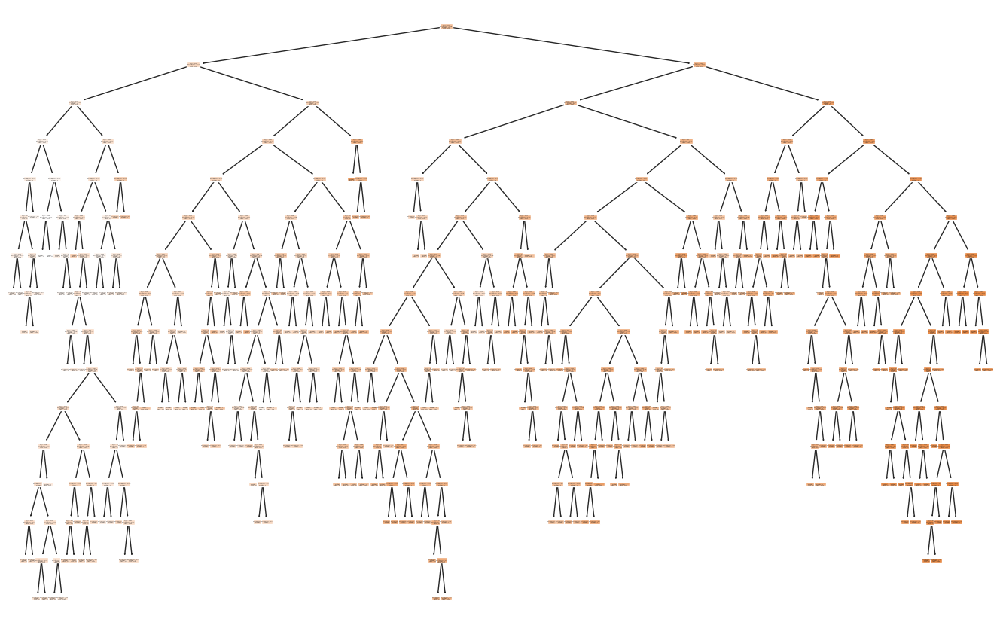

In [ ]:
from sklearn.tree import DecisionTreeRegressor
regressor=DecisionTreeRegressor()
regressor.fit(X_train,y_train)
from sklearn import tree
plt.figure(figsize=(15,10))
tree.plot_tree(regressor, filled=True)

In [ ]:
y_pred=regressor.predict(X_test)

In [ ]:
from sklearn.metrics import accuracy_score

In [ ]:
from sklearn.metrics import mean_squared_error # for calculating the cost function
# RMSE (Root Mean Square Error)
rmse = float(format(np.sqrt(mean_squared_error(y_test, y_pred)), '.3f'))
print("\nRMSE: ", rmse)


RMSE:  0.585


In [ ]:
r2_score1=r2_score(y_pred,y_test);r2_score1

0.6842535764727157

In [ ]:
!pip install dtreeviz

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 91.8/91.8 kB 2.6 MB/s eta 0:00:00


In [ ]:
# Sample code
from io import StringIO
from sklearn.datasets import *
from sklearn import tree
from dtreeviz.trees import *
from IPython.display import display, HTML

In [ ]:
from sklearn.tree import DecisionTreeClassifier , DecisionTreeRegressor
import dtreeviz
from mpl_toolkits.mplot3d import Axes3D
%matplotlib inline

In [ ]:
dtree_reg = DecisionTreeRegressor()
dtree_reg.fit(X_train, y_train)

DecisionTreeRegressor()

In [ ]:
X_train

,GDP per capita,Social support,Healthy life expectancy
131,0.541,0.872,0.080
71,1.269,1.487,0.920
106,0.323,0.688,0.449
180,1.038,1.252,0.761
251,0.000,0.712,0.115
142,0.882,1.232,0.758
181,0.685,1.328,0.739
116,0.755,0.765,0.588
305,0.715,1.365,0.702
296,1.433,1.457,0.874


In [ ]:
#dot_data = StringIO()
#viz_model = dtreeviz.model(dtree_reg,X_train,y_train)
#viz_model.view()

In [ ]:
!pip install graphviz

In [ ]:
import graphviz
# DOT data
data = tree.export_graphviz(regressor, out_file=None,
                                feature_names=list(X_train.columns),
                                filled=True)



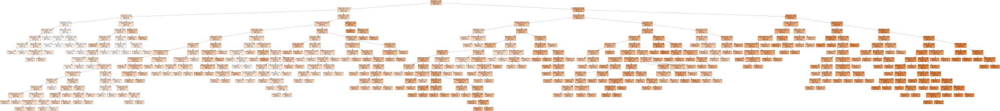

In [ ]:
# Draw graph
graph = graphviz.Source(data, format="png")
graph

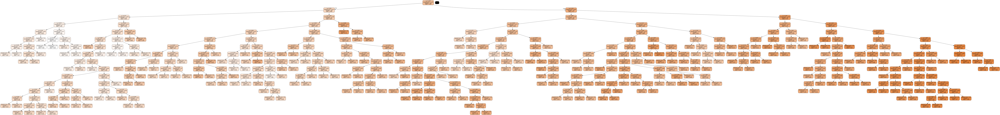

In [ ]:
from six import StringIO
from IPython.display import Image
from sklearn.tree import export_graphviz
import pydotplus
import graphviz
import os
import os

dot_data = StringIO()
export_graphviz(regressor, out_file=dot_data,
                filled=True, rounded=True,
                special_characters=True)
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
Image(graph.create_png())

Mean Squared Error: 0.2847247248293515


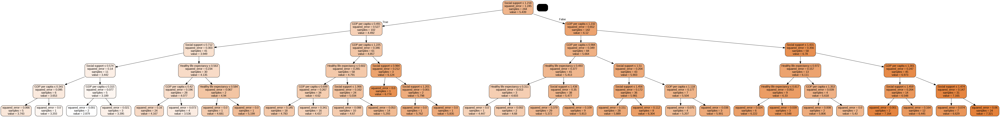

In [ ]:
import pandas as pd
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt
from sklearn.tree import export_graphviz
import graphviz
from IPython.display import Image
import io
import pydot
# Fit the Decision Tree regression model with postpruning
max_depth = 5  # Set the maximum depth for postpruning
model = DecisionTreeRegressor(random_state=0, max_depth=max_depth)
model.fit(X_train, y_train)

# Predict on test data
y_pred = model.predict(X_test)

# Calculate Mean Squared Error
mse = mean_squared_error(y_test, y_pred)
print(f"Mean Squared Error: {mse}")

# Visualize the pruned Decision Tree
dot_data = io.StringIO()
export_graphviz(
    model,
    out_file=dot_data,
    feature_names=independent_vars,
    filled=True,
    rounded=True,
    special_characters=True
)

graph = pydot.graph_from_dot_data(dot_data.getvalue())
Image(graph[0].create_png())

In [ ]:
 #Data Processing
import pandas as pd
import numpy as np

# Modelling
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import accuracy_score, confusion_matrix, precision_score, recall_score, ConfusionMatrixDisplay
from sklearn.model_selection import RandomizedSearchCV, train_test_split
from scipy.stats import randint

# Tree Visualisation
from sklearn.tree import export_graphviz
from IPython.display import Image
import graphviz

In [ ]:
# Import the model we are using
from sklearn.ensemble import RandomForestRegressor
# Initializing the Random Forest Regression model with 10 decision trees
model = RandomForestRegressor(n_estimators = 10, random_state = 0)

# Fitting the Random Forest Regression model to the data
model.fit(X_train, y_train)

RandomForestRegressor(n_estimators=10, random_state=0)

In [ ]:
# Use the forest's predict method on the test data
y_pred = model.predict(X_test);y_pred


array([5.8223, 5.0337, 4.0503, 4.3774, 3.6926, 7.1937, 4.6868, 3.896 ,
       4.724 , 4.1662, 5.5149, 4.6503, 5.8777, 7.0957, 5.1428, 4.0089,
       4.5309, 5.5313, 4.9262, 4.9594, 7.0561, 5.5616, 7.4202, 6.1074,
       6.0243, 4.2561, 5.4273, 6.533 , 4.1768, 4.6237, 6.6302, 5.0832,
       5.4759, 5.736 , 6.1526, 4.6542, 5.7136, 6.3938, 5.3029, 5.9753,
       7.0536, 6.1057, 5.8005, 4.5255, 4.4254, 3.6824, 5.6701, 5.1227,
       4.7617, 4.3259, 6.0279, 5.414 , 5.4698, 5.2809, 5.8163, 3.3214,
       5.7311, 6.9257, 4.3978, 4.3913, 6.2712])

In [ ]:
y_train_pred=model.predict(X_train);y_train_pred

array([4.7643, 6.852 , 3.5783, 5.9884, 4.4388, 5.7311, 5.6357, 4.0325,
       5.1758, 6.8743, 6.777 , 5.1979, 5.471 , 5.668 , 4.5796, 7.2045,
       6.3884, 4.1686, 3.5075, 4.9304, 4.9196, 6.4347, 5.3262, 5.7564,
       4.8493, 4.2296, 5.6434, 4.1245, 4.447 , 6.3532, 5.6794, 3.751 ,
       4.5081, 4.8134, 5.6518, 3.9352, 3.4155, 5.5384, 6.2526, 6.622 ,
       4.8838, 6.5193, 3.2117, 4.3956, 4.9414, 6.6642, 5.9776, 5.4892,
       6.1272, 6.1148, 4.0561, 5.7136, 5.6875, 4.9847, 5.6591, 6.1376,
       6.141 , 5.604 , 5.8366, 6.3449, 3.8203, 4.2909, 3.9779, 7.5935,
       6.0563, 5.5092, 4.5305, 5.9255, 4.9659, 7.4976, 4.7832, 4.4646,
       7.4795, 6.4415, 6.6135, 5.1782, 5.432 , 5.9142, 6.4921, 6.4852,
       4.7178, 5.6416, 7.119 , 4.6254, 3.3054, 7.3069, 7.1454, 5.792 ,
       7.439 , 4.6061, 5.3886, 5.0209, 7.0022, 5.339 , 5.7361, 4.189 ,
       3.651 , 4.5597, 7.2221, 6.4868, 5.7285, 4.1693, 5.2322, 4.6758,
       4.6134, 5.2938, 4.8547, 4.9758, 4.6287, 4.6688, 4.1445, 4.685 ,
      

In [ ]:
from sklearn.metrics import mean_squared_error # for calculating the cost function
# RMSE (Root Mean Square Error)
rmse = float(format(np.sqrt(mean_squared_error(y_test, y_pred)), '.3f'))
print("\nRMSE: ", rmse)


RMSE:  0.496


In [ ]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler(feature_range=(0, 1))

X_train_scaled = scaler.fit_transform(X_train)
X_train = pd.DataFrame(X_train_scaled)

X_test_scaled = scaler.fit_transform(X_test)
X_test = pd.DataFrame(X_test_scaled)

In [ ]:
from sklearn import neighbors
from sklearn.metrics import mean_squared_error
from math import sqrt

KNN

In [ ]:
rmse_val = [] #to store rmse values for different k
for K in range(20):
    K = K+1
    model = neighbors.KNeighborsRegressor(n_neighbors = K)

    model.fit(X_train, y_train)  #fit the model
    pred=model.predict(X_test) #make prediction on test set
    error = sqrt(mean_squared_error(y_test,pred)) #calculate rmse
    rmse_val.append(error) #store rmse values
    print('RMSE value for k= ' , K , 'is:', error)

RMSE value for k=  1 is: 0.6653815126504863
RMSE value for k=  2 is: 0.6351350508253228
RMSE value for k=  3 is: 0.6529720995888951
RMSE value for k=  4 is: 0.6491079834513884
RMSE value for k=  5 is: 0.6435809307509269
RMSE value for k=  6 is: 0.6269506216339634
RMSE value for k=  7 is: 0.6531332568379046
RMSE value for k=  8 is: 0.6392911716115043
RMSE value for k=  9 is: 0.6313784202623344
RMSE value for k=  10 is: 0.6316551973669303
RMSE value for k=  11 is: 0.6203975519589269
RMSE value for k=  12 is: 0.6267284554906342
RMSE value for k=  13 is: 0.6279295256509348
RMSE value for k=  14 is: 0.6299856804678289
RMSE value for k=  15 is: 0.6283152961710786
RMSE value for k=  16 is: 0.6322042467373384
RMSE value for k=  17 is: 0.6264317956488218
RMSE value for k=  18 is: 0.6278034757059568
RMSE value for k=  19 is: 0.6286931131452971
RMSE value for k=  20 is: 0.6237423115265828


In [ ]:
from sklearn.model_selection import GridSearchCV
params = {'n_neighbors':[1,2,3,4,5,6,7,8,9,10]}

knn = neighbors.KNeighborsRegressor()

model = GridSearchCV(knn, params, cv=5)
model.fit(X_train,y_train)
model.best_params_

{'n_neighbors': 9}

<Axes: >

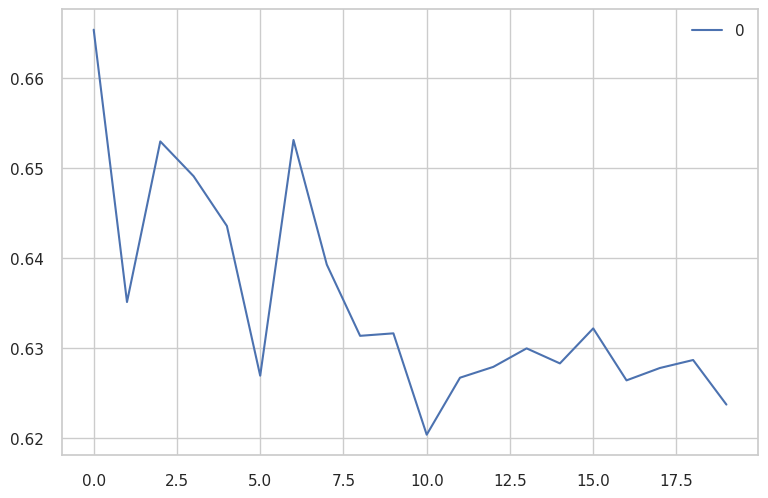

In [ ]:
#plotting the rmse values against k values
curve = pd.DataFrame(rmse_val) #elbow curve
curve.plot()

In [ ]:

df['Score'].shape

(305,)

In [ ]:
from sklearn.model_selection import cross_val_score, train_test_split
from sklearn.neighbors import KNeighborsRegressor
import numpy as np
accuracy_rate = []

# Will take some time
for i in range(1,20):

    knn = KNeighborsRegressor(n_neighbors=i)
    score=cross_val_score(knn,X_train,y_train,cv=10)
    accuracy_rate.append(score.mean())
error_rate = []

# Will take some time
for i in range(1,20):

    knn = KNeighborsRegressor(n_neighbors=i)
    score=cross_val_score(knn,X_train,y_train,cv=5)
    error_rate.append(1-score.mean())
error_rate = []

# Will take some time
for i in range(1,40):

    knn = KNeighborsRegressor(n_neighbors=i)
    knn.fit(X_train,y_train)
    pred_i = knn.predict(X_test)
    error_rate.append(np.mean(pred_i != y_test))

In [ ]:
# FIRST A QUICK COMPARISON TO OUR ORIGINAL K=1
knn = KNeighborsRegressor(n_neighbors=5)

knn.fit(X_train,y_train)
pred = knn.predict(X_test)
from sklearn.metrics import mean_squared_error

# Assuming you have already defined and trained your KNN model with n_neighbors=1

# Predict using the trained model
pred = knn.predict(X_test)

# Calculate Mean Squared Error
mse = mean_squared_error(y_test, pred)
print(f"Mean Squared Error: {mse}")


Mean Squared Error: 0.4141964144262294


In [ ]:
from sklearn.model_selection import GridSearchCV
params = {'n_neighbors':[2,3,4,5,6,7,8,9]}

knn = neighbors.KNeighborsRegressor()

model = GridSearchCV(knn, params, cv=5)
model.fit(X_train,y_train)
model.best_params_

{'n_neighbors': 9}

In [ ]:
y_pred=model.predict(X_test)

In [ ]:
mse1=mean_squared_error(y_test,y_pred)
print(f"Mean squared error :{mse1}")

Mean squared error :0.3986387095729609


SVR

In [ ]:
from sklearn.preprocessing import StandardScaler
sc_X = StandardScaler()
scaled_X_train = sc_X.fit_transform(X_train)
scaled_X_test = sc_X.fit_transform(X_test)

In [ ]:
from sklearn.svm import SVR

In [ ]:
regressor = SVR(kernel='linear')
regressor.fit(scaled_X_train,y_train)

SVR(kernel='linear')

In [ ]:
y_pred = regressor.predict(scaled_X_test);y_pred

array([6.12255344, 5.38961442, 3.99204588, 4.44431238, 4.36928073,
       6.6028653 , 5.46179619, 3.66230526, 4.67824017, 3.54625314,
       5.42509375, 5.57553035, 6.33351946, 6.46717426, 4.87381937,
       3.93519652, 4.31681601, 5.39462975, 5.2710414 , 5.44158888,
       6.86830212, 6.08091665, 6.69002179, 6.08082667, 5.91398987,
       4.00841832, 5.35050619, 6.5475585 , 3.96199062, 4.85868652,
       6.48627167, 5.60708699, 5.64302675, 5.64619997, 6.48208532,
       4.80280082, 6.3236017 , 6.29078387, 5.20320274, 6.08682005,
       6.80758058, 6.10799226, 6.00017927, 4.06977446, 4.77109889,
       4.49492937, 6.26753975, 5.3343738 , 5.01020823, 3.44717179,
       5.95036023, 5.98811037, 5.5300296 , 5.90310634, 6.10138618,
       3.09831534, 6.12031431, 6.66290831, 4.66801547, 4.88630579,
       6.43285363])

In [ ]:
kernels = ['Polynomial', 'RBF', 'Sigmoid','Linear']

In [ ]:
#A function which returns the corresponding SVC model
def getRegressor(ktype):
    if ktype == 0:
        # Polynomial kernal
        return SVR(kernel='poly', degree=8, gamma="auto")
    elif ktype == 1:
        # Radial Basis Function kernal
        return SVR(kernel='rbf', gamma="auto")
    elif ktype == 2:
        # Sigmoid kernal
        return SVR(kernel='sigmoid', gamma="auto")
    elif ktype == 3:
        # Linear kernal
        return SVR(kernel='linear', gamma="auto")

In [ ]:
for i in range(4):
    svregressor = getRegressor(i)
    svregressor.fit(scaled_X_train, y_train)# Make prediction
    y_pred = svregressor.predict(scaled_X_test)# Evaluate our model

In [ ]:
y_pred

array([6.12255344, 5.38961442, 3.99204588, 4.44431238, 4.36928073,
       6.6028653 , 5.46179619, 3.66230526, 4.67824017, 3.54625314,
       5.42509375, 5.57553035, 6.33351946, 6.46717426, 4.87381937,
       3.93519652, 4.31681601, 5.39462975, 5.2710414 , 5.44158888,
       6.86830212, 6.08091665, 6.69002179, 6.08082667, 5.91398987,
       4.00841832, 5.35050619, 6.5475585 , 3.96199062, 4.85868652,
       6.48627167, 5.60708699, 5.64302675, 5.64619997, 6.48208532,
       4.80280082, 6.3236017 , 6.29078387, 5.20320274, 6.08682005,
       6.80758058, 6.10799226, 6.00017927, 4.06977446, 4.77109889,
       4.49492937, 6.26753975, 5.3343738 , 5.01020823, 3.44717179,
       5.95036023, 5.98811037, 5.5300296 , 5.90310634, 6.10138618,
       3.09831534, 6.12031431, 6.66290831, 4.66801547, 4.88630579,
       6.43285363])

In [ ]:
from sklearn.metrics import mean_squared_error # for calculating the cost function
# RMSE (Root Mean Square Error)
rmse = float(format(np.sqrt(mean_squared_error(y_test, y_pred)), '.3f'))
print("\nRMSE: ", rmse)


RMSE:  0.561


In [ ]:
parameters = [
	{"kernel":
		["linear"],
		"C": [0.0001, 0.001, 0.1, 1, 10, 100, 1000]},
	{"kernel":
		["poly"],
		"degree": [2, 3, 4],
		"C": [0.0001, 0.001, 0.1, 1, 10, 100, 1000]},
	{"kernel":
		["rbf"],
		"gamma": ["auto", "scale"],
		"C": [0.0001, 0.001, 0.1, 1, 10, 100, 1000]},
 {"kernel":
		["sigmoid"],
		"degree": [2, 3, 4],
		"C": [0.0001, 0.001, 0.1, 1, 10, 100, 1000]},
]

In [ ]:
import time

In [ ]:
# tune the hyperparameters via a cross-validated grid search
print("[INFO] tuning hyperparameters via grid search")
grid = GridSearchCV(estimator=SVR(), param_grid=parameters, n_jobs=-1)
start = time.time()
grid.fit(scaled_X_train,y_train)
end = time.time()
# show the grid search information
print("[INFO] grid search took {:.2f} seconds".format(
	end - start))
print("[INFO] grid search best score: {:.2f}%".format(
	grid.best_score_ * 100))
print("[INFO] grid search best parameters: {}".format(
	grid.best_params_))

[INFO] tuning hyperparameters via grid search
[INFO] grid search took 41.88 seconds
[INFO] grid search best score: 73.80%
[INFO] grid search best parameters: {'C': 1, 'gamma': 'scale', 'kernel': 'rbf'}


In [ ]:
model1=SVR(kernel='rbf',C=1,gamma='scale')

In [ ]:
model=model1.fit(scaled_X_train,y_train)

In [ ]:
y_pred=model.predict(scaled_X_test)

In [ ]:
from sklearn.metrics import mean_squared_error # for calculating the cost function
# RMSE (Root Mean Square Error)
rmse = float(format(np.sqrt(mean_squared_error(y_test, y_pred)), '.3f'))
print("\nRMSE: ", rmse)


RMSE:  0.454


In [ ]:
from sklearn.model_selection import GridSearchCV

# defining parameter range
param_grid = {'C': [0.1, 1, 10, 100, 1000],
			'gamma': [1, 0.1, 0.01, 0.001, 0.0001],
			'kernel': ['linear','rbf','sigmoid','poly']}

grid = GridSearchCV(SVR(), param_grid, refit = True, verbose = 3)

# fitting the model for grid search

In [ ]:
grid.fit(scaled_X_train, y_train)

Fitting 5 folds for each of 100 candidates, totalling 500 fits
[CV 1/5] END .....C=0.1, gamma=1, kernel=linear;, score=0.612 total time=   0.0s
[CV 2/5] END .....C=0.1, gamma=1, kernel=linear;, score=0.737 total time=   0.0s
[CV 3/5] END .....C=0.1, gamma=1, kernel=linear;, score=0.588 total time=   0.0s
[CV 4/5] END .....C=0.1, gamma=1, kernel=linear;, score=0.794 total time=   0.0s
[CV 5/5] END .....C=0.1, gamma=1, kernel=linear;, score=0.669 total time=   0.0s
[CV 1/5] END ........C=0.1, gamma=1, kernel=rbf;, score=0.657 total time=   0.0s
[CV 2/5] END ........C=0.1, gamma=1, kernel=rbf;, score=0.681 total time=   0.0s
[CV 3/5] END ........C=0.1, gamma=1, kernel=rbf;, score=0.533 total time=   0.0s
[CV 4/5] END ........C=0.1, gamma=1, kernel=rbf;, score=0.732 total time=   0.0s
[CV 5/5] END ........C=0.1, gamma=1, kernel=rbf;, score=0.662 total time=   0.0s
[CV 1/5] END ...C=0.1, gamma=1, kernel=sigmoid;, score=-1.413 total time=   0.0s
[CV 2/5] END ...C=0.1, gamma=1, kernel=sigmoid

GridSearchCV(estimator=SVR(),
             param_grid={'C': [0.1, 1, 10, 100, 1000],
                         'gamma': [1, 0.1, 0.01, 0.001, 0.0001],
                         'kernel': ['linear', 'rbf', 'sigmoid', 'poly']},
             verbose=3)

In [ ]:
print(grid.best_estimator_)

SVR(C=1000, gamma=0.01)


In [ ]:
print(grid.best_score_)

0.7300393610125175


In [ ]:
grid_predictions = grid.predict(scaled_X_test);grid_predictions

array([6.29910458, 5.16372108, 4.23175728, 4.42628269, 4.36222845,
       7.02306141, 5.25215604, 3.7457291 , 4.62388545, 4.04982223,
       5.15782447, 4.7033139 , 6.46377054, 6.66538092, 4.86635751,
       4.1266121 , 4.08942067, 5.2680763 , 4.72131565, 5.22216869,
       7.20364319, 6.00441268, 7.1985607 , 6.05197733, 5.5888579 ,
       4.18250618, 5.13920191, 6.82518944, 4.16476382, 4.44009812,
       6.79826679, 5.47636188, 5.26665116, 5.46725571, 6.51959436,
       4.3871238 , 6.34761772, 6.28802658, 5.16810416, 6.06582538,
       7.33372956, 5.81940076, 5.58847166, 4.05616929, 4.66903817,
       4.43655296, 6.28590475, 5.13347682, 4.86211992, 4.41431989,
       5.75979875, 6.01803408, 5.32136143, 5.53146888, 6.14816841,
       3.53432756, 6.21737613, 7.02089516, 4.48015482, 4.63079891,
       6.69503342])

In [ ]:
from sklearn.metrics import mean_squared_error # for calculating the cost function
# RMSE (Root Mean Square Error)
rmse = float(format(np.sqrt(mean_squared_error(y_test,grid_predictions )), '.3f'))
print("\nRMSE: ", rmse)


RMSE:  0.468
